# Exploring Precipitation Data and begginging to develop an XGBoost model
### Author: Ben Newell

In [1]:
#Importing all the libraries 
#%matplotlib notebook  #run this once or smth
#!pip install pycountry-convert
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import geopandas as gpd
import pycountry
from pycountry_convert.convert_country_alpha2_to_continent_code import COUNTRY_ALPHA2_TO_CONTINENT_CODE
from pycountry_convert.convert_continent_code_to_continent_name import CONTINENT_CODE_TO_CONTINENT_NAME
from IPython.display import HTML
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures


## Cleaning the Data

In [2]:
precipitation = pd.read_csv(r"C:\Users\benne\OneDrive\Desktop\Important things\data science\Group project\datasets\precipitation.csv") #importing the dataset
main = pd.read_csv(r"C:\Users\benne\OneDrive\Desktop\Important things\data science\Group project\datasets\crane_temp_rain_pop_tree_2001-2023.csv")

In [3]:
bird = pd.read_csv(r"C:\Users\benne\OneDrive\Desktop\Important things\data science\Group project\datasets\clean_crane_data.csv")

In [4]:
print(precipitation.isna().any().any()) #searching for nan values
precipitation = precipitation.dropna() #removing the nan values
print(precipitation.isna().any().any()) #checking it worked

True
False


In [5]:
#melting the table
precip_clean = precipitation.melt(id_vars=['code', 'name'], var_name='date', value_name='precipitation')

In [6]:
#cleaning the date format
precip_clean["date"] = pd.to_datetime(precip_clean["date"], format="%Y-%m")

In [7]:
#adding in continents to the dataset
# This code is from:
# https://stackoverflow.com/questions/78382398/how-to-add-a-column-on-a-pandas-dataframe-that-is-based-on-the-continent-a-count

alpha3_to_continent = {x.alpha_3: CONTINENT_CODE_TO_CONTINENT_NAME.get(
                         COUNTRY_ALPHA2_TO_CONTINENT_CODE.get(x.alpha_2)
                       ) for x in pycountry.countries}

# move the column before the years for clarity (optional)
precip_clean.insert(2, 'continent', precip_clean['code'].map(alpha3_to_continent))

In [8]:
precip_clean

,code,name,continent,date,precipitation
0,ABW,Aruba (Neth.),North America,1901-01-01,33.30
1,AFG,Afghanistan,Asia,1901-01-01,48.01
2,AGO,Angola,Africa,1901-01-01,152.68
3,AIA,Anguilla (U.K.),North America,1901-01-01,92.60
4,ALA,Finland,Europe,1901-01-01,15.14
...,...,...,...,...,...
360139,WSM,Samoa,Oceania,2023-12-01,577.97
360140,YEM,Republic of Yemen,Asia,2023-12-01,3.41
360141,ZAF,South Africa,Africa,2023-12-01,97.65
360142,ZMB,Zambia,Africa,2023-12-01,224.23


In [9]:
#looking for any countries that dont have a continent assigned
no_continent = precip_clean[precip_clean['continent'].isna()]
no_continent['name'].unique()    

array(['French Southern and Antarctic Lands (Fr.)', 'Kosovo',
       'Pitcairn Islands (U.K.)', 'Sint Maarten (Neth.)', 'Timor-Leste',
       'U.S. Minor Outlying Islands', 'Vatican City'], dtype=object)

In [10]:
#manually adding some of the country's continents
precip_clean.loc[precip_clean['name'] == 'Kosovo', 'Continent'] = 'Europe'   #adds the continent for kosovo and vatican, don't care for pacific islands
precip_clean.loc[precip_clean['name'] == 'Vatican City', 'Continent'] = 'Europe'


In [11]:
precip_clean

,code,name,continent,date,precipitation,Continent
0,ABW,Aruba (Neth.),North America,1901-01-01,33.30,NaN
1,AFG,Afghanistan,Asia,1901-01-01,48.01,NaN
2,AGO,Angola,Africa,1901-01-01,152.68,NaN
3,AIA,Anguilla (U.K.),North America,1901-01-01,92.60,NaN
4,ALA,Finland,Europe,1901-01-01,15.14,NaN
...,...,...,...,...,...,...
360139,WSM,Samoa,Oceania,2023-12-01,577.97,NaN
360140,YEM,Republic of Yemen,Asia,2023-12-01,3.41,NaN
360141,ZAF,South Africa,Africa,2023-12-01,97.65,NaN
360142,ZMB,Zambia,Africa,2023-12-01,224.23,NaN


In [12]:
#removes any countries that dont have a continent
precip_clean = precip_clean.dropna(subset=['continent'])
precip_clean

,code,name,continent,date,precipitation,Continent
0,ABW,Aruba (Neth.),North America,1901-01-01,33.30,NaN
1,AFG,Afghanistan,Asia,1901-01-01,48.01,NaN
2,AGO,Angola,Africa,1901-01-01,152.68,NaN
3,AIA,Anguilla (U.K.),North America,1901-01-01,92.60,NaN
4,ALA,Finland,Europe,1901-01-01,15.14,NaN
...,...,...,...,...,...,...
360139,WSM,Samoa,Oceania,2023-12-01,577.97,NaN
360140,YEM,Republic of Yemen,Asia,2023-12-01,3.41,NaN
360141,ZAF,South Africa,Africa,2023-12-01,97.65,NaN
360142,ZMB,Zambia,Africa,2023-12-01,224.23,NaN


In [13]:
#a random extra continent column appears so removing that
precip_clean = precip_clean.drop(precip_clean.columns[5], axis=1)

In [14]:
#adding a year column
precip_clean["year"] = precip_clean["date"].dt.year

In [15]:
#exporting to a csv file
precip_clean.to_csv(r"C:\Users\benne\OneDrive\Desktop\Important things\data science\Group project\datasets\cleaned_precipitation.csv", index=False)

## Plotting the data for basic initial analysis

In [16]:
def plotting(title, x, y, legend, led_loc):       #function for plotting visuals, just for simplicity
    plt.title(title)
    plt.xlabel(x)
    plt.ylabel(y)
    plt.grid()
    if legend == None:
        pass
    else:
        plt.legend(title = legend, loc = led_loc)

In [17]:
def best_fit(x, y, degree, size):                         #function to calculate line of best fit
    x_fit = np.linspace(x.min(), x.max(), size)
    if size == 1:
        slope, intercept = np.polyfit(x, y, degree)             #Calculate line of best fit, 1 = Linear fit 
        trendline = np.poly1d([slope, intercept])               #Generate the euqation of best fit    
    else:
        coeff = np.polyfit(x,y,degree)
        trendline = np.poly1d(coeff)
    y_fit = trendline(x_fit)                                    #plot the y values for LOBF
    return y_fit, x_fit

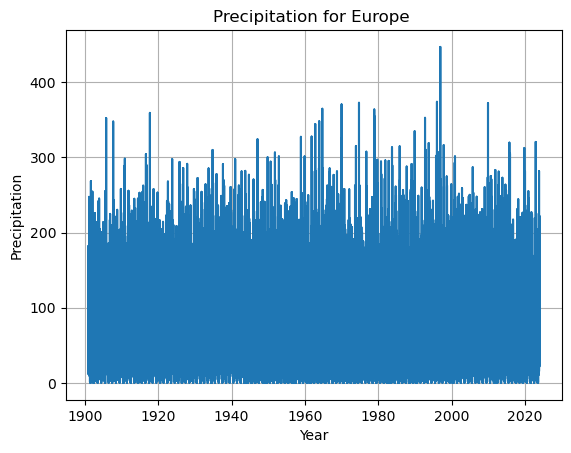

In [18]:
#plotting the continent/ counties data
place = 'Europe'
land_mass = 'continent'
country = precip_clean[precip_clean[land_mass] == place]    #select the continent or country
plt.plot(country['date'], country['precipitation'])
plotting(f'Precipitation for {place} ','Year', 'Precipitation', None, 2)
plt.show()

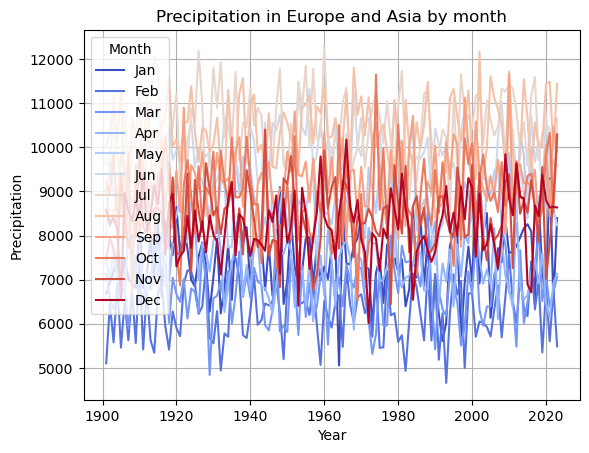

In [148]:
#plots monthly rainfall, can be done for continent, worldwide and countries also done with smoothing and LOBF
smoothing = 1   #set the degree of smoothing
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']  #array containing month names
colors = plt.cm.coolwarm(np.linspace(0, 1, 12))     #for visuals, an array going from blue to red
place = 'Europe and Asia'
land_type = 'continent'

for month in range(12):    #loops through all the months and plots
    precip_select = precip_clean[(precip_clean["date"].dt.month == month + 1)  & (precip_clean[land_type].isin(['Europe', 'Asia']))]  #creates dataframe containing specified month and continent
    precip_select = precip_select.groupby("year")["precipitation"].sum().reset_index()  #sums the precipitation in the continent, can be changed to average if needed
    precip_select["moving_average"] = precip_select["precipitation"].rolling(window= smoothing).mean()  #smoothing function
    plt.plot(precip_select['year'], precip_select['moving_average'], label = months[month], color = colors[month])    #adds the line to the plot
    #best_fit(precip_select['year'], precip_select['precipitation'], colors[month], f'best fit for {months[month]}', 1)

plotting(f"Precipitation in {place} by month", 'Year', 'Precipitation', "Month", 2)
plt.show()

## Looking at how precipitation changes

C:\Users\benne\AppData\Local\Temp\ipykernel_32628\3223052198.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  precip_spec['month'] = precip_spec['date'].dt.month
C:\Users\benne\AppData\Local\Temp\ipykernel_32628\3223052198.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  precip_spec['month'] = precip_spec['date'].dt.month
C:\Users\benne\AppData\Local\Temp\ipykernel_32628\3223052198.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

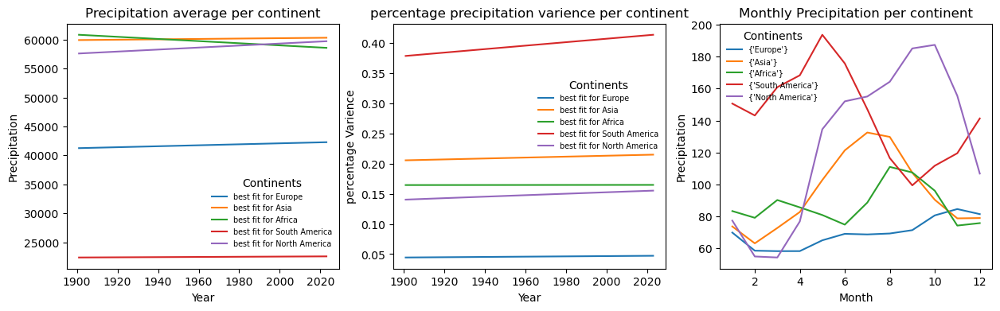

<Figure size 300x300 with 0 Axes>

In [198]:
land_type = 'continent'
place = 'Europe'
colors1 = plt.cm.copper(np.linspace(0, 1, 5))
place = ['Europe', 'Asia', 'Africa', 'South America', 'North America']
x = 0

fig, axes = plt.subplots(1, 3, figsize=(15, 4))
for i in place:   
    precip_spec = precip_clean[precip_clean[land_type] == i]  #creates dataframe containing specified month and continent
    precip_spec1 = precip_spec.groupby("year")["precipitation"].sum().reset_index()  #sums the precipitation in the continent, can be changed to average if needed
    precip_spec1["moving_average"] = precip_spec1["precipitation"].rolling(window= smoothing).mean()  #smoothing function
    #plt.plot(precip_spec['year'], precip_spec['moving_average'], label = 'Average yearly precipitation', color = colors[month])    #adds the line to the plot
    ypl, xpl = best_fit(precip_spec1['year'], precip_spec1['precipitation'], 1, len(precip_spec1['year']))   #plots line of best fit    
    axes[0].plot(precip_spec1['year'], ypl, label = f'best fit for {i}')
    precip_spec2 = precip_spec.groupby('year')['precipitation'].var()#
    ypl1, xpl1 = best_fit(precip_spec2.index, precip_spec2.values, 1, len(precip_spec1['year']))
    axes[1].plot(xpl, ypl1/ypl, label = f'best fit for {i}')
    precip_spec['month'] = precip_spec['date'].dt.month
    precip_spec3 = precip_spec.groupby("month")["precipitation"].mean()
    axes[2].plot(precip_spec3.index, precip_spec3.values, label = {i})
    
    x+= 1
#print(trendline)
axes[0].set_title("Precipitation average per continent")
axes[1].set_title("percentage precipitation varience per continent")
axes[2].set_title("Monthly Precipitation per continent")
axes[0].set_xlabel("Year")
axes[1].set_xlabel("Year")
axes[2].set_xlabel("Month")
axes[0].set_ylabel("Precipitation")
axes[1].set_ylabel("percentage Varience")
axes[2].set_ylabel("Precipitation")

axes[0].legend(fontsize = 'x-small', frameon = False, title = 'Continents', bbox_to_anchor = (0.5, 0., 0.5, 0.4))
axes[1].legend(fontsize = 'x-small', frameon = False, title = 'Continents', bbox_to_anchor = (0.5, 0.4, 0.5, 0.4))
axes[2].legend(fontsize = 'x-small', frameon = False, title = 'Continents', bbox_to_anchor = (0.0, 0.6, 0.5, 0.4))


plt.figure(figsize=(3,3))
plt.show()

## Animating on a map how precipitation changes, just for fun

In [21]:
from matplotlib import colormaps
list(colormaps)

['magma',
 'inferno',
 'plasma',
 'viridis',
 'cividis',
 'twilight',
 'twilight_shifted',
 'turbo',
 'Blues',
 'BrBG',
 'BuGn',
 'BuPu',
 'CMRmap',
 'GnBu',
 'Greens',
 'Greys',
 'OrRd',
 'Oranges',
 'PRGn',
 'PiYG',
 'PuBu',
 'PuBuGn',
 'PuOr',
 'PuRd',
 'Purples',
 'RdBu',
 'RdGy',
 'RdPu',
 'RdYlBu',
 'RdYlGn',
 'Reds',
 'Spectral',
 'Wistia',
 'YlGn',
 'YlGnBu',
 'YlOrBr',
 'YlOrRd',
 'afmhot',
 'autumn',
 'binary',
 'bone',
 'brg',
 'bwr',
 'cool',
 'coolwarm',
 'copper',
 'cubehelix',
 'flag',
 'gist_earth',
 'gist_gray',
 'gist_heat',
 'gist_ncar',
 'gist_rainbow',
 'gist_stern',
 'gist_yarg',
 'gnuplot',
 'gnuplot2',
 'gray',
 'hot',
 'hsv',
 'jet',
 'nipy_spectral',
 'ocean',
 'pink',
 'prism',
 'rainbow',
 'seismic',
 'spring',
 'summer',
 'terrain',
 'winter',
 'Accent',
 'Dark2',
 'Paired',
 'Pastel1',
 'Pastel2',
 'Set1',
 'Set2',
 'Set3',
 'tab10',
 'tab20',
 'tab20b',
 'tab20c',
 'grey',
 'gist_grey',
 'gist_yerg',
 'Grays',
 'magma_r',
 'inferno_r',
 'plasma_r',
 'viri

In [22]:
precip_clean1 = precip_clean #just making a copy for map stuff as it will be heavily edited

In [23]:
world = gpd.read_file("https://naciscdn.org/naturalearth/110m/cultural/ne_110m_admin_0_countries.zip") #import world data
countries = world['SOV_A3'].dropna().unique()  # Country codes
years = np.arange(1900, 2021)  # Time range    #

In [24]:
#Matching some of the coutnries codes in both data sets as they were all not the same
world[world == 'AU1'] = 'AUS' #australia
world[world == 'CH1'] = 'CHN' #china
world[world == 'CU1'] = 'CUB' #cuba
world[world == 'DN1'] = 'DNK'
world[world == 'FI1'] = 'FIN' #finland
world[world == 'FR1'] = 'FRA' #france
world[world == 'GB1'] = 'GBR' #UK
world[world == 'KA1'] = 'KAZ' #Borat
world[world == 'NL1'] = 'NLD' #nether
world[world == 'NZ1'] = 'NZL' #new zealand
world[world == 'US1'] = 'USA' #USA

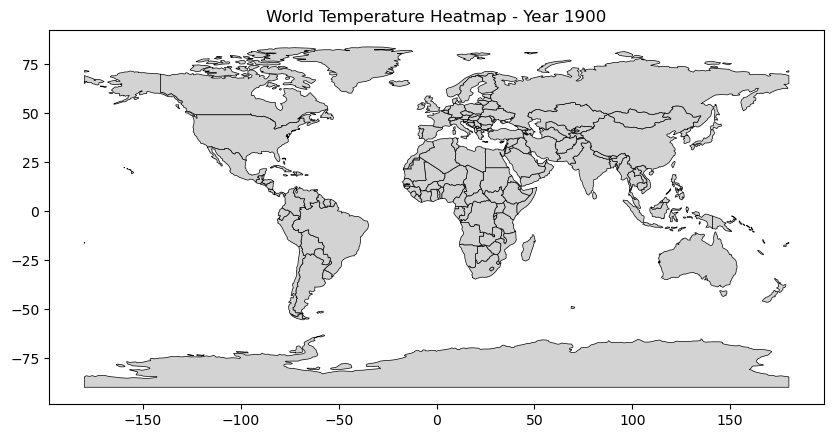

In [25]:
#renaming code to SOV_A£ to prepare for merge
precip_clean1 = precip_clean1.rename(columns={'code': 'SOV_A3'})

#grouping the counties and summing the precipitation for the year
precip_clean1 = precip_clean1.groupby(["name", 'SOV_A3','year'])["precipitation"].sum().reset_index()  

# Merge with world map
merged = world.merge(precip_clean1, on="SOV_A3", how="left")

# Initialize figure
fig, ax = plt.subplots(figsize=(10, 6))

def update(year):    #update function for animation
    ax.clear()
    ax.set_title(f"World Temperature Heatmap - Year {year}")
    current_data = world.merge(precip_clean1[precip_clean1["year"] == year], on="SOV_A3", how="left")     # Merge data for current year
    current_data.plot(column='precipitation', cmap='coolwarm', linewidth=0.5, edgecolor='black',
                      legend=False, ax=ax, missing_kwds={"color": "lightgrey"})                           # Plot world map
    return ax.collections
    
# Create animation
anim = animation.FuncAnimation(fig, update, frames=years, repeat=False, interval=200, blit = False)  #create animation
HTML(anim.to_jshtml())   #convert to jshtml so can be displayed in jupyter notebook

In [26]:
# Define the date format regex (DD/MM/YYYY)
date_pattern = r"^\d{2}/\d{2}/\d{4}$"

# Keep only rows where the date matches the format
bird = bird[bird["OBSERVATION DATE"].astype(str).str.match(date_pattern)]

# Reset index after filtering (optional)
bird.reset_index(drop=True, inplace=True)
bird

,GLOBAL UNIQUE IDENTIFIER,OBSERVATION COUNT,COUNTRY,LATITUDE,LONGITUDE,OBSERVATION DATE,TIME OBSERVATIONS STARTED,DURATION MINUTES
0,URN:CornellLabOfOrnithology:EBIRD:OBS533741645,7,United Kingdom,52.744315,1.624603,08/10/1993,NaN,NaN
1,URN:CornellLabOfOrnithology:EBIRD:OBS776499119,2,Finland,59.809343,22.893696,15/04/1984,NaN,NaN
2,URN:CornellLabOfOrnithology:EBIRD:OBS1919716399,35,Finland,61.481060,23.823474,20/04/1972,14:20:00,NaN
3,URN:CornellLabOfOrnithology:EBIRD:OBS1565666077,20,Sweden,57.278110,14.000840,27/05/1991,NaN,NaN
4,URN:CornellLabOfOrnithology:EBIRD:OBS1044855853,20,Sweden,57.295939,13.944397,20/07/1995,10:30:00,450.0
...,...,...,...,...,...,...,...,...
269447,URN:CornellLabOfOrnithology:EBIRD:OBS2380171875,X,Estonia,58.421718,24.997158,23/05/2024,21:05:00,95.0
269448,URN:CornellLabOfOrnithology:EBIRD:OBS2203812967,1,Spain,42.029547,-1.183709,30/05/2024,10:49:00,17.0
269449,URN:CornellLabOfOrnithology:EBIRD:OBS2356830335,70,Lithuania,55.699346,24.963632,30/07/2024,19:42:00,NaN
269450,URN:CornellLabOfOrnithology:EBIRD:OBS2107003445,X,Finland,61.727326,29.698195,29/04/2024,13:06:00,240.0


In [27]:
# bird_uk = bird
# # Convert 'OBSERVATION COUNT' to numeric, replacing 'X' with NaN
# bird_uk["OBSERVATION COUNT"] = pd.to_numeric(bird_uk["OBSERVATION COUNT"], errors="coerce")
# print(bird_uk['OBSERVATION DATE'])

# # Convert 'OBSERVATION DATE' to datetime
# bird_uk["OBSERVATION DATE"] = pd.to_datetime(bird_uk["OBSERVATION DATE"], errors="coerce")

# # Group by 'OBSERVATION DATE' and sum the 'OBSERVATION COUNT'
# bird_uk_grouped = bird_uk.groupby("OBSERVATION DATE")["OBSERVATION COUNT"].sum()

# # Convert index to datetime (just in case)
# bird_uk_grouped.index = pd.to_datetime(bird_uk_grouped.index, errors="coerce")

# # Filter out dates before 1960-10-10
# start_date = pd.to_datetime("1960-10-10")
# bird_uk_grouped = bird_uk_grouped[bird_uk_grouped.index >= start_date]

# #finding the line of best fit
# x = (bird_uk_grouped.index - bird_uk_grouped.index.min()).days
# y = bird_uk_grouped.values
# ydl, xdl = best_fit(x, y, 4, len(y))

# #plotting the lines
# plt.plot(bird_uk_grouped.index, bird_uk_grouped.values, linestyle="-", color="b")
# plt.plot(bird_uk_grouped.index.min() + pd.to_timedelta(xdl, unit="D"), ydl, linestyle="-", color="g", label="Quadratic Best Fit")

# plt.xlabel("Observation Date")
# plt.ylabel("Number of Birds Spotted")
# plt.title("Number of Birds Spotted in the UK Over Time")
# plt.xticks(rotation=45)
# plt.grid(True)
# plt.show()

In [28]:
precip_clean = precip_clean.rename(columns={'name': 'COUNTRY'})
#precip_clean['date'] = precip_clean['date'].dt.to_period('M')
bird["OBSERVATION COUNT"] = pd.to_numeric(bird["OBSERVATION COUNT"], errors = 'coerce')
bird["OBSERVATION DATE"] = pd.to_datetime(bird["OBSERVATION DATE"], format = '%d/%m/%Y')
bird['date'] = bird['OBSERVATION DATE'].dt.to_period('M')
bird_grouped = bird.groupby("date")["OBSERVATION COUNT"].sum()
precip_clean['date'] = precip_clean['date'].dt.to_period('M')
bird

,GLOBAL UNIQUE IDENTIFIER,OBSERVATION COUNT,COUNTRY,LATITUDE,LONGITUDE,OBSERVATION DATE,TIME OBSERVATIONS STARTED,DURATION MINUTES,date
0,URN:CornellLabOfOrnithology:EBIRD:OBS533741645,7.0,United Kingdom,52.744315,1.624603,1993-10-08,NaN,NaN,1993-10
1,URN:CornellLabOfOrnithology:EBIRD:OBS776499119,2.0,Finland,59.809343,22.893696,1984-04-15,NaN,NaN,1984-04
2,URN:CornellLabOfOrnithology:EBIRD:OBS1919716399,35.0,Finland,61.481060,23.823474,1972-04-20,14:20:00,NaN,1972-04
3,URN:CornellLabOfOrnithology:EBIRD:OBS1565666077,20.0,Sweden,57.278110,14.000840,1991-05-27,NaN,NaN,1991-05
4,URN:CornellLabOfOrnithology:EBIRD:OBS1044855853,20.0,Sweden,57.295939,13.944397,1995-07-20,10:30:00,450.0,1995-07
...,...,...,...,...,...,...,...,...,...
269447,URN:CornellLabOfOrnithology:EBIRD:OBS2380171875,NaN,Estonia,58.421718,24.997158,2024-05-23,21:05:00,95.0,2024-05
269448,URN:CornellLabOfOrnithology:EBIRD:OBS2203812967,1.0,Spain,42.029547,-1.183709,2024-05-30,10:49:00,17.0,2024-05
269449,URN:CornellLabOfOrnithology:EBIRD:OBS2356830335,70.0,Lithuania,55.699346,24.963632,2024-07-30,19:42:00,NaN,2024-07
269450,URN:CornellLabOfOrnithology:EBIRD:OBS2107003445,NaN,Finland,61.727326,29.698195,2024-04-29,13:06:00,240.0,2024-04


In [29]:
precip_bird = pd.merge(precip_clean, bird, on=["COUNTRY", "date"])
precip_bird

,code,COUNTRY,continent,date,precipitation,year,GLOBAL UNIQUE IDENTIFIER,OBSERVATION COUNT,LATITUDE,LONGITUDE,OBSERVATION DATE,TIME OBSERVATIONS STARTED,DURATION MINUTES
0,CHN,China,Asia,1903-11,14.68,1903,URN:CornellLabOfOrnithology:EBIRD:OBS2156297433,NaN,19.940944,109.986461,1903-11-15,NaN,NaN
1,TWN,China,Asia,1903-11,107.10,1903,URN:CornellLabOfOrnithology:EBIRD:OBS2156297433,NaN,19.940944,109.986461,1903-11-15,NaN,NaN
2,UKR,Ukraine,Europe,1905-05,42.34,1905,URN:CornellLabOfOrnithology:EBIRD:OBS887280860,2.0,51.912453,25.969860,1905-05-25,NaN,NaN
3,CHN,China,Asia,1909-03,26.70,1909,URN:CornellLabOfOrnithology:EBIRD:OBS2175947576,1.0,26.032106,119.361819,1909-03-18,NaN,NaN
4,TWN,China,Asia,1909-03,126.68,1909,URN:CornellLabOfOrnithology:EBIRD:OBS2175947576,1.0,26.032106,119.361819,1909-03-18,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
256882,TWN,China,Asia,2023-12,86.11,2023,URN:CornellLabOfOrnithology:EBIRD:OBS1910769617,40.0,26.864487,100.130904,2023-12-31,09:30:00,90.0
256883,TWN,China,Asia,2023-12,86.11,2023,URN:CornellLabOfOrnithology:EBIRD:OBS1896615656,126.0,26.852336,104.215831,2023-12-14,07:43:00,323.0
256884,UKR,Ukraine,Europe,2023-12,53.98,2023,URN:CornellLabOfOrnithology:EBIRD:OBS1892092580,3.0,47.663011,31.688418,2023-12-07,19:32:00,48.0
256885,UKR,Ukraine,Europe,2023-12,53.98,2023,URN:CornellLabOfOrnithology:EBIRD:OBS1914497023,21.0,48.619066,35.656471,2023-12-30,09:00:00,300.0


## Correlation between birds and rain

In [30]:
precip_bird_late = precip_bird[precip_bird["OBSERVATION DATE"] > '1999-11-11']

In [134]:
df1 = precip_bird_late[(precip_bird_late['continent'].isin(['Europe','Asia']) & (precip_bird_late['OBSERVATION COUNT'] <= 40000))]

In [136]:
# Example: Assuming your dataset is in a DataFrame called 'df'
correlation = df1["precipitation"].corr(df1["OBSERVATION COUNT"])

print(f"Correlation between precipitation and bird count: {correlation}")

Correlation between precipitation and bird count: -0.013082281765306639


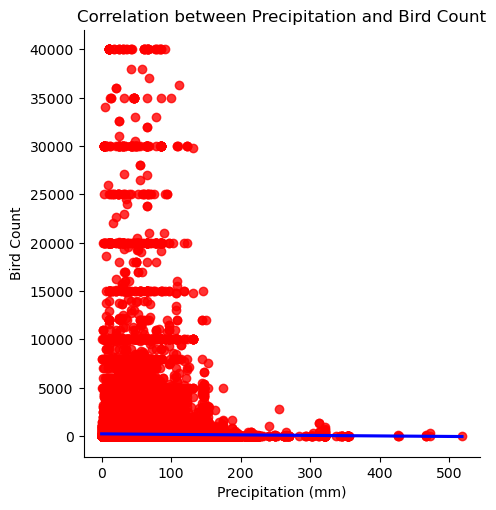

In [146]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a scatter plot with a regression line
sns.lmplot(x="precipitation", y="OBSERVATION COUNT", data=df1,  scatter_kws={"color": "red"},  # Scatter points in blue
    line_kws={"color": "blue"} )

# Add labels and title
plt.xlabel("Precipitation (mm)")
plt.ylabel("Bird Count")
plt.title("Correlation between Precipitation and Bird Count")

# Show the plot
plt.show()

## Initial modelling, just testing the waters and getting a knack for it

In [ ]:
X = main[['year', 'percentage_loss','Population', 'AVERAGE MONTH TEMPERATURE', 'AVERAGE MONTH RAINFALL']]
y = main['OBSERVATION COUNT']

y = pd.to_numeric(y, errors="coerce")
y.fillna(0, inplace=True)
print("NaN values:", y.isna().sum())  # Count NaNs

# Train-Test Splitting of the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

poly = PolynomialFeatures(degree=2, interaction_only=True)
X_train = poly.fit_transform(X_train)
X_test = poly.transform(X_test)


xgb_model = xgb.XGBRegressor(
    objective="reg:squarederror",  # Use reg:squarederror for regression
    eval_metric="rmse",  # Use RMSE for regression evaluation
    max_depth = 15,       #controls depth of trees, could lead to over fitting
    n_estimators=2000,     #number of booting rounds, more usually better
    learning_rate=0.02,   #how much each tree contirbutes 
    gamma=0.1,            #how much to split tree, lower means more details
    booster = 'gbtree'    #most common kind, can be gblinear or dart
)


xgb_model.fit(X_train, y_train)

# Model Performance
y_pred = xgb_model.predict(X_test)
# Calculate RMSE
rmse = mean_squared_error(y_test, y_pred, squared=False)
print(f"RMSE: {rmse:.4f}")

# Mean squared error
mse = mean_squared_error(y_test, y_pred)
print(f"MSE: {mse:.4f}")
y

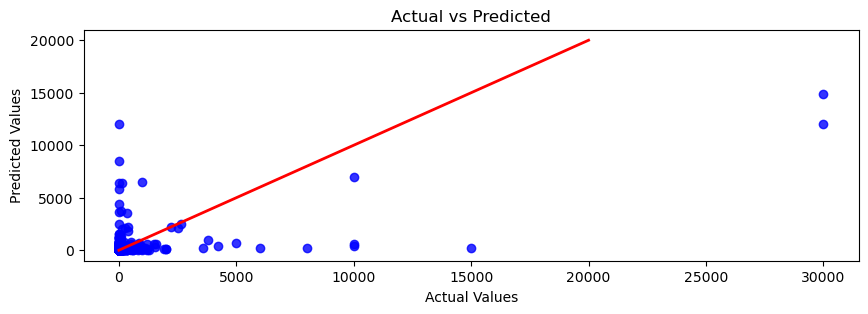

In [35]:
# Scatter plot of Actual vs Predicted
plt.figure(figsize=(10,3))
plt.scatter(y_test[0:900], y_pred[0:900], color='blue', alpha=0.8)
plt.plot([min(y_test), max(y_test) - 40000], [min(y_test), max(y_test) - 40000], color='red', linewidth=2)  # Ideal line
plt.title('Actual vs Predicted')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.show()


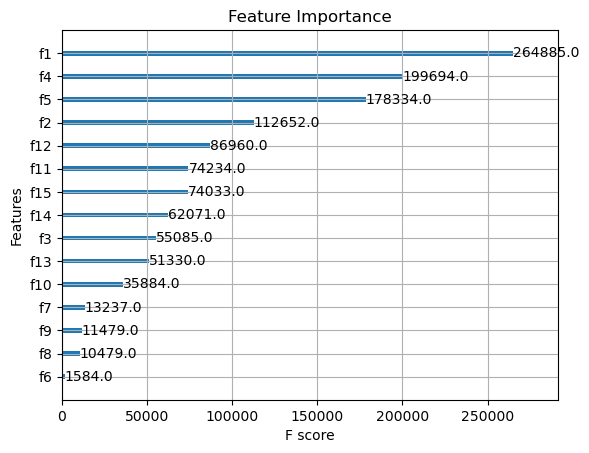

XGBRegressor(base_score=None, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric='rmse', feature_types=None,
             gamma=0.1, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.02, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=15, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=2000, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [36]:
# Plot feature importance
xgb.plot_importance(xgb_model, importance_type='weight', max_num_features=15, title="Feature Importance")
plt.show()
xgb_model

In [37]:
main["OBSERVATION COUNT"] = main["OBSERVATION COUNT"].replace("X", 1)

In [38]:
len(main["OBSERVATION COUNT"])

99427

In [39]:
print(f"X shape: {X.shape}")
print(f"y shape: {y.shape}")

X shape: (99427, 5)
y shape: (99427,)


In [40]:
#prediciting
#'year', 'percentage_loss','Population', 'AVERAGE MONTH TEMPERATURE', 'AVERAGE MONTH RAINFALL'
input = [[2021, 30, 30000000, 12, 10]]
input = poly.fit_transform(input)

output = xgb_model.predict(input)
print(output)

[6.8580856]
